# IMPORT AND INSTALL

In [1]:
import csv
from collections import defaultdict
import os
import networkx as nx
import matplotlib.pyplot as plt
import random
import pandas as pd
import numpy as np
import matplotlib.colors as mcolors
from matplotlib.lines import Line2D
import ast  # to convert string representation of tuple to actual tuple

# SETUP

In [2]:
cmap = plt.cm.jet  #i like plasma more
cmap = cmap.reversed()  # Reverse the colormap
cmap.set_bad('gray')    # Set the color for masked values (if applicable)

In [3]:
font_family='sans serif'
font_weight='bold'
font_size='8'
edge_color='#9BCFCA'
font_color='white'
node_col='#55827D'

highlight='#E10686'


#COLORS:
#light pink E1A8B4
#blue 69A5D0
#mint 9BCFCA
#hot pint E10686


# old node color E8186C
#old edge color BAC8E0

In [4]:
figsize=(30,30)
figsize_B=(40,80)

# LOAD DATA

In [5]:
# The directory where the .csv files are located
directory= r"C:\Users\Georgios Bekakos\Desktop"

In [6]:
nodes_csv = 'C:\\Users\\Georgios Bekakos\\Desktop\\nodes_final.csv'
hor_edges_csv = 'C:\\Users\\Georgios Bekakos\\Desktop\\edges_final.csv'
vert_edges_csv = 'C:\\Users\\Georgios Bekakos\\Desktop\\edges_vertical_final.csv'

nodes = pd.read_csv(nodes_csv)
hor_edges = pd.read_csv(hor_edges_csv)
vert_edges = pd.read_csv(vert_edges_csv)


In [7]:
#nodes=pd.read_csv(nodes_csv)
#hor_edges=pd.read_csv(hor_edges_csv)
#vert_edges=pd.read_csv(vert_edges_csv)

## COMBINE EDGES

In [8]:
#replace column names in vertical edges list
new_column_names={'Source Room Number':'vi Room Number',
                  'Target Room Number':'vj Room Number',
                  'Source Room Unique ID':'vi Room Unique ID',
                  'Target Room Unique ID':'vj Room Unique ID'}
                  # Use the rename method to replace specific column names
vert_edges.rename(columns=new_column_names, inplace=True)

In [9]:
edges = pd.concat([hor_edges, vert_edges], ignore_index=True)

## ADD FEATURES FOR NODES FOR PRESENTATION

getting the multipliers for y by level

In [10]:
#Extract a list of levels to use as multipliers for X or Y coordinates

multipliers_A=list(nodes['Level'])


# Single value for multiplication
scale = 0.1
# Multiply each integer by the multiplier using a list comprehension
multipliers = [x * scale for x in multipliers_A]


In [11]:

#First, we want to manipulate the position of the centroids based on level so they dont overlap too much


# List of strings
coordinates_strings = list(nodes['Centroid'])

# Convert the list of strings to a list of tuples
coordinates_tuples = [(float(x), float(y)) for x, y in [coord.strip('()').split(',') for coord in coordinates_strings]]

# Multiply the x values by the corresponding multipliers
modified_coordinates = [(x, y* multiplier ) for (x, y), multiplier in zip(coordinates_tuples, multipliers)]

#convert back to string for consistency

modified_coordinates_str=[str(t) for t in modified_coordinates]

In [12]:
# Add new centroids to dataframe
nodes['Centroids_Edited'] = modified_coordinates_str

THRESHOLD FOR POINT FIXING (MIGHT DELETE LATER)

In [13]:
node_stats=nodes.describe()
fix_threshold=node_stats.loc[['75%'],['Degree Centrality']]
fix_threshold=fix_threshold.iloc[0,0]

#this gives me a threshold for nodes to fix positions of

# GRAPH BUILDER

SET UP THE DEFAULT GRAPH WITH ITS NODE AND EDGE ATTRIBUTES

In [14]:
# Create graph from edge list
G = nx.from_pandas_edgelist(edges, 'vi', 'vj',edge_attr=True)

In [15]:
# Iterate through nodes DataFrame and set node attributes
node_attributes={}

for _, row in nodes.iterrows():
    node_id = row['Index']
    node_attributes[node_id] = {
        'Room Number': row['Room Number'],
        'Room Name': row['Room Name'],
        'Room Unique ID': row['Room Unique ID'],
        'Polygon Points': row['Polygon Points'],
        'Touching Wall Unique IDs': row['Touching Wall Unique IDs'],
        'Area': row['Area'],
        'Centroid': row['Centroid'],
        'Level': row['Level'],
        'Degree Centrality': row['Degree Centrality'],
        'Closeness Centrality': row['Closeness Centrality'],
        'Betweenness Centrality': row['Betweenness Centrality'],
        'PageRank': row['PageRank'],
        'Clustering': row['Clustering'],
        'Core Number': row['Core Number'],
        'Centroids_Edited': row['Centroids_Edited']

    }
    nx.set_node_attributes(G, node_attributes)

POSITION NODES BASED ON FIXED CENTROID RELATED LOCATION

In [16]:
# Create position dictionary based on centroids
pos = {row['Index']: ast.literal_eval(row['Centroids_Edited']) for _, row in nodes.iterrows()}

##PLAIN GRAPH

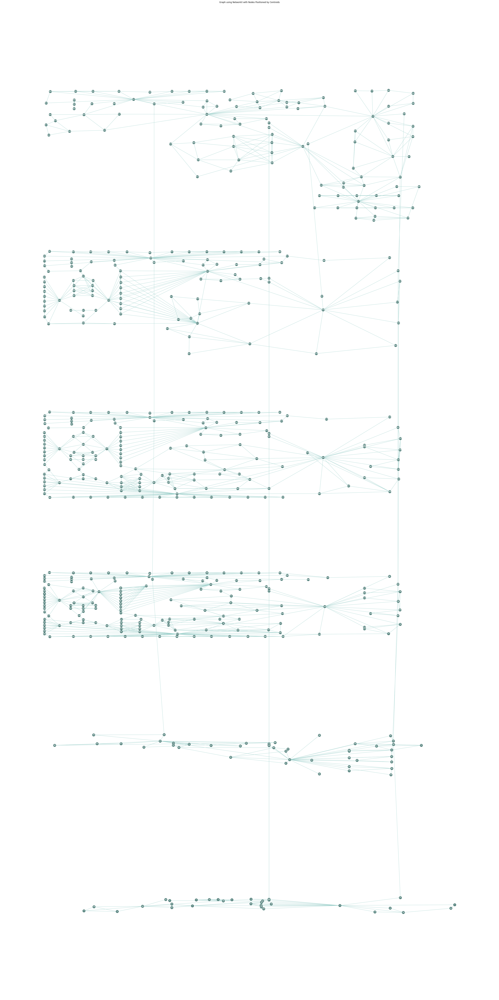

In [17]:
# Plot using networkx
plt.figure(figsize=figsize_B)
nx.draw(G, pos, with_labels=True, node_color=node_col, font_family=font_family,font_weight=font_weight, font_size=font_size,
        edge_color=edge_color, font_color=font_color, node_size=250)


plt.title("Graph using NetworkX with Nodes Positioned by Centroids")
plt.show()


## NODES COLORED BY LEVEL

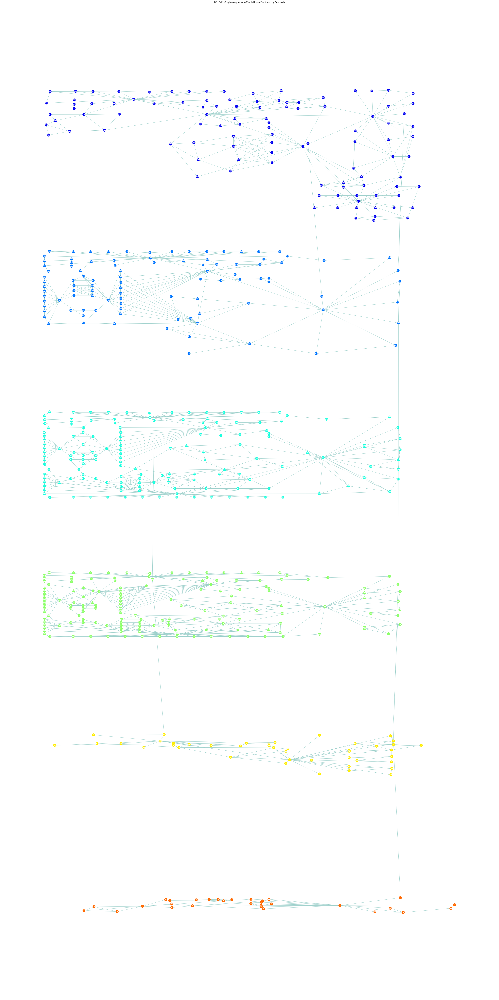

In [18]:
# Get a list of unique level values
unique_levels = nodes["Level"].unique()

# Create a color mapping for each unique level
colors = cmap(np.linspace(0.2, 0.9, len(unique_levels)))
level_to_color = {n: colors[i] for i, n in enumerate(unique_levels)}

# Create a list of node colors based on their levels
node_colors_mapped = [level_to_color[G.nodes[node]['Level']] for node in G.nodes]

# Plot using networkx
plt.figure(figsize=figsize_B)
nx.draw(G, pos, with_labels=True, node_color=node_colors_mapped, font_family=font_family, font_weight=font_weight, font_size=font_size, edge_color=edge_color, font_color=font_color, node_size=250)

plt.title("BY LEVEL Graph using NetworkX with Nodes Positioned by Centroids")
plt.show()


## NODES COLORED BY PROGRAM & SIZED BY AREA

JUST SIZED

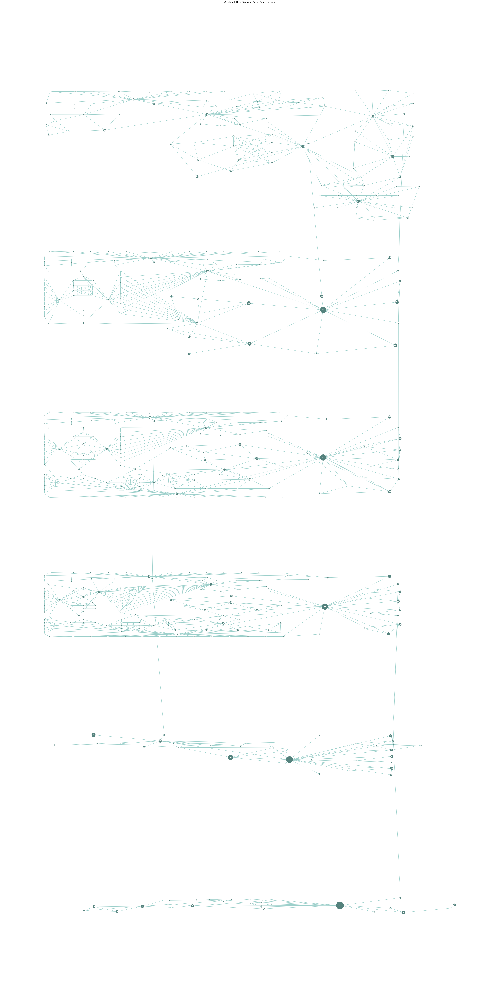

In [19]:
# Get the area attribute values for each node
area_values = nx.get_node_attributes(G, 'Area')

# Define a mapping from area values to node sizes
min_size = 10  # Minimum node size
max_size = 2000 # Maximum node size
normalized_area = [(val - min(area_values.values())) / (max(area_values.values()) - min(area_values.values())) for val in area_values.values()]
node_sizes = [min_size + (max_size - min_size) * val for val in normalized_area]

#Define a colormap from green to pink based on node size
##I also like this cm PuRd
cmap_B=plt.cm.BuGn
norm = mcolors.Normalize(vmin=min(node_sizes), vmax=max(node_sizes))
node_colors = [cmap_B(norm(size)) for size in node_sizes]


plt.figure(figsize=figsize_B)  # Adjust the figure size as needed
nx.draw(G, pos, with_labels=True, node_size=node_sizes, font_family=font_family, font_weight=font_weight, font_size=font_size, font_color=font_color, node_color=node_col, edge_color=edge_color)

plt.title("Graph with Node Sizes and Colors Based on area")
plt.show()


SIZED AND COLORED

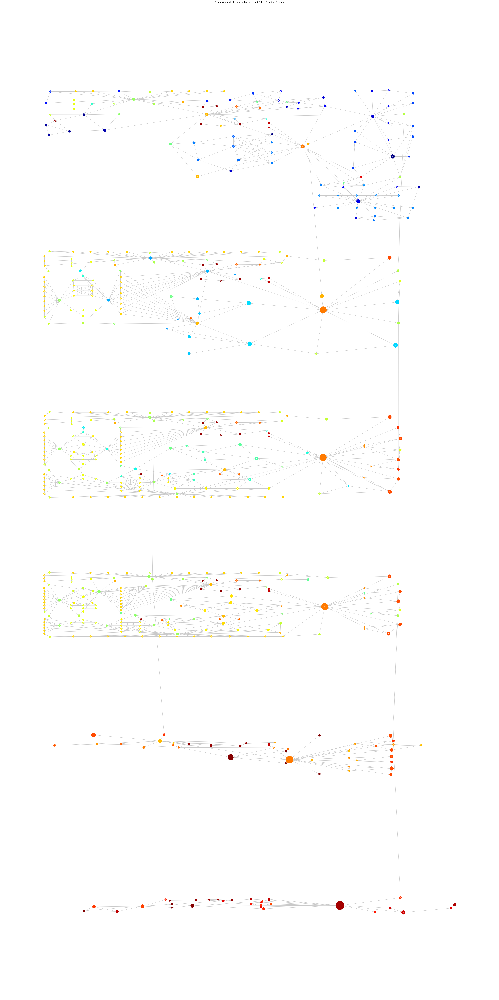

In [20]:

# Get a list of unique room names ]
unique_rooms = nodes["Room Name"].unique()


#testing
# cmap = plt.cm.gist_rainbow

# Create a color mapping for each unique rooms
colors = cmap(np.linspace(0, 1, len(unique_rooms)))
room_to_color = {n: colors[i] for i, n in enumerate(unique_rooms)}

for node in G.nodes():
  node_colors_mapped=[room_to_color[G.nodes[node]['Room Name']] for node in G.nodes]

# Get the area attribute values for each node
area_values = nx.get_node_attributes(G, 'Area')

# Define a mapping from area values to node sizes
min_size = 100  # Minimum node size
max_size = 2500 # Maximum node size
normalized_area = [(val - min(area_values.values())) / (max(area_values.values()) - min(area_values.values())) for val in area_values.values()]
node_sizes = [min_size + (max_size - min_size) * val for val in normalized_area]


plt.figure(figsize=figsize_B)  # Adjust the figure size as needed
nx.draw(G, pos, with_labels=True, node_size=node_sizes, font_family=font_family, font_weight=font_weight, font_size=2, font_color=font_color, node_color=node_colors_mapped, edge_color='#c9c9c9')

plt.title("Graph with Node Sizes based on Area and Colors Based on Program")
plt.show()



#Plot the legend in a separate figure

# # Create a separate figure for the legend
# legend_fig = plt.figure(figsize=(4, 4))

# # Create custom legend labels
# legend_labels = [Line2D([0], [0], marker='o', color='w', label=room, markerfacecolor=color, markersize=10) for room, color in room_to_color.items()]

# # Plot the legend
# plt.legend(handles=legend_labels, title='Room Names', loc='center')
# plt.axis('off')
# # Show the legend figure
# plt.show()

TRY ITERATING NON SEQUENTIALLY

##BAR GRAPH OF THE UNIQUE PROGRAMS WITH REF TO PREVIOUS COLORS

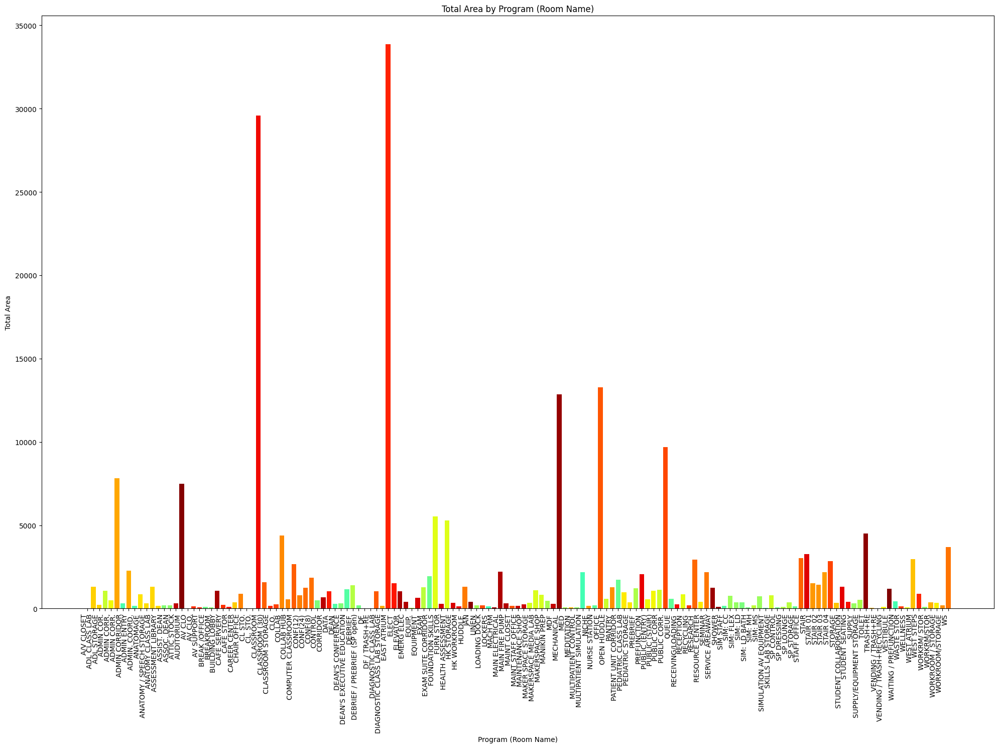

147

In [21]:
# Calculate the total area for each program (Room Name)
program_total_area = nodes.groupby('Room Name')['Area'].sum().reset_index()

program_colors = {program: cmap(i) for i, program in enumerate(unique_rooms)}

# Create a bar graph with the same colors as the node colors
plt.figure(figsize=(20,15))  # Adjust the figure size as needed
for i, row in program_total_area.iterrows():
    program = row['Room Name']
    color = program_colors.get(program, 'skyblue')  # Default to 'skyblue' if program not found in colors
    plt.bar(program, row['Area'], color=color)

plt.xlabel('Program (Room Name)')
plt.ylabel('Total Area')
plt.title('Total Area by Program (Room Name)')
plt.xticks(rotation=90, ha='right')  # Rotate x-axis labels for readability

# Show the bar graph
plt.tight_layout()
plt.show()

len(unique_rooms)

grouping is definitely needed.... to make sense of things

## NOW BY GROUPED PROGRAM

## NODES SIZED BY CENTRALITY

NO NODE COLORING

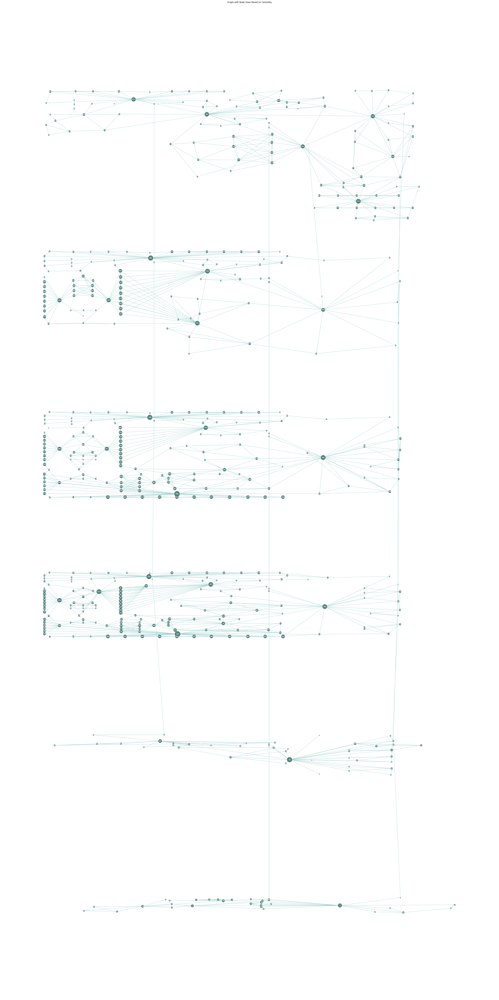

In [22]:


# Get the centrality attribute values for each node
centrality_values = nx.get_node_attributes(G, 'Degree Centrality')

# Define a mapping from centrality values to node sizes
min_size = 10  # Minimum node size
max_size = 1000  # Maximum node size
normalized_centrality = [(val - min(centrality_values.values())) / (max(centrality_values.values()) - min(centrality_values.values())) for val in centrality_values.values()]
node_sizes = [min_size + (max_size - min_size) * val for val in normalized_centrality]


plt.figure(figsize=figsize_B)  # Adjust the figure size as needed
nx.draw(G, pos, with_labels=True, node_size=node_sizes, font_size=font_size, font_color=font_color,font_weight=font_weight,font_family=font_family, node_color=node_col, edge_color=edge_color)

plt.title("Graph with Node Sizes Based on Centrality")
plt.show()


GRADIENT COLORS

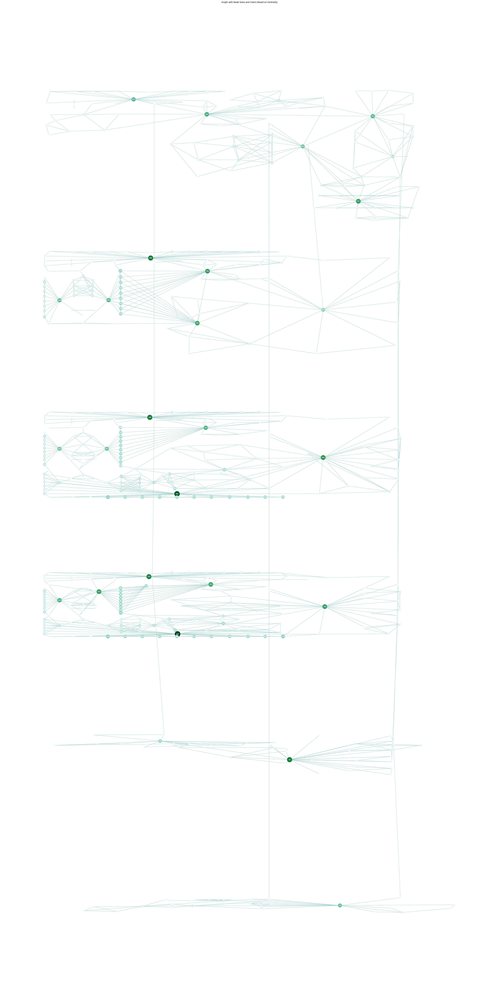

In [23]:
# Get the centrality attribute values for each node
centrality_values = nx.get_node_attributes(G, 'Degree Centrality')

# Define a mapping from centrality values to node sizes
min_size = 10  # Minimum node size
max_size = 1000 # Maximum node size
normalized_centrality = [(val - min(centrality_values.values())) / (max(centrality_values.values()) - min(centrality_values.values())) for val in centrality_values.values()]
node_sizes = [min_size + (max_size - min_size) * val for val in normalized_centrality]

# Define a colormap from green to pink based on node size
##I also like this cm PuRd
cmap_B=plt.cm.BuGn
norm = mcolors.Normalize(vmin=min(node_sizes), vmax=max(node_sizes))
node_colors = [cmap_B(norm(size)) for size in node_sizes]


plt.figure(figsize=figsize_B)  # Adjust the figure size as needed
nx.draw(G, pos, with_labels=True, node_size=node_sizes, font_family=font_family,font_size=font_size,font_weight=font_weight, font_color=font_color, node_color=node_colors, edge_color=edge_color)

plt.title("Graph with Node Sizes and Colors Based on Centrality")
plt.show()


## ACCESS GRAPH

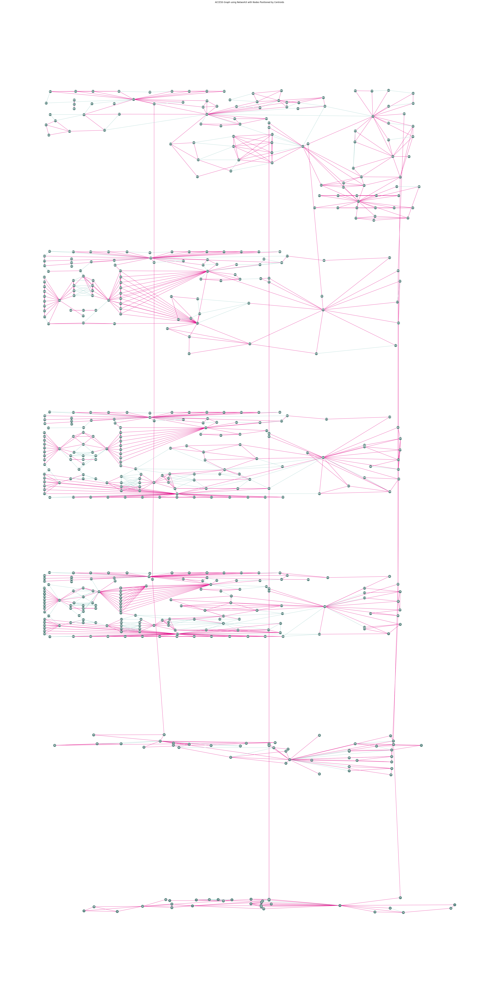

In [24]:

edge_colors_mapped = [highlight if G[vi][vj]['Access'] == 1 else edge_color for vi, vj in G.edges]

# Plot using networkx
plt.figure(figsize=figsize_B)
nx.draw(G, pos, with_labels=True, node_color=node_col, font_family=font_family,font_weight=font_weight, font_size=font_size,
        edge_color=edge_colors_mapped, font_color=font_color, node_size=250)


plt.title("ACCESS Graph using NetworkX with Nodes Positioned by Centroids")
plt.show()

##EDGE USABILITY (THEN EDGE USABILITY + EXPERIENTIAL IMPORTANCE) !! USE ACCESS GRAPH

In [25]:
#First I create the access subgraph

# Create a subgraph with edges where Access == 1
access_subgraph = G.edge_subgraph([(vi, vj) for vi, vj in G.edges if G[vi][vj]['Access'] == 1])




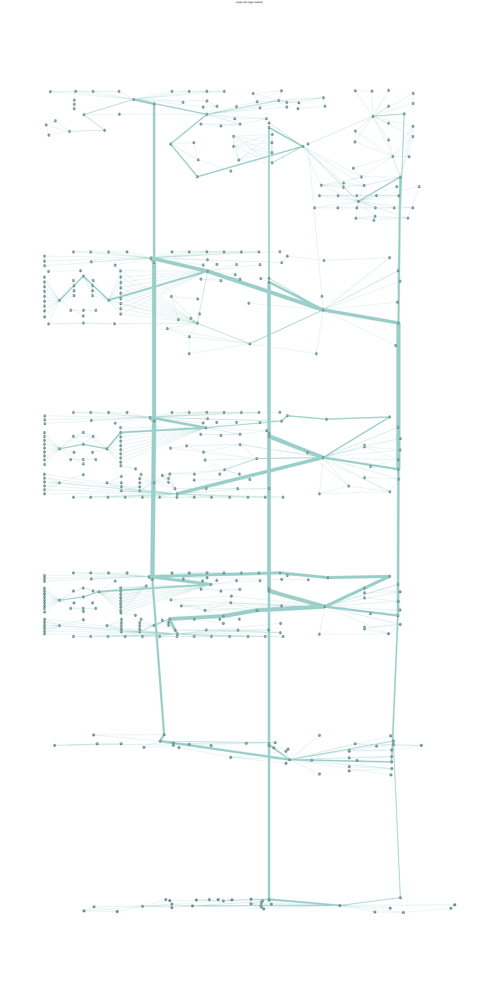

In [26]:


# Get the largest connected component
largest_cc = max(nx.connected_components(access_subgraph), key=len)
G_sub = access_subgraph.subgraph(largest_cc).copy()

# Calculate shortest paths using Dijkstra's algorithm
shortest_paths = dict(nx.shortest_path(G_sub))

# Initialize a dictionary to count edge usage
edge_usage = {}

# Iterate through each pair of nodes and count edge usage
for source in shortest_paths:
    for target in shortest_paths[source]:
        path = shortest_paths[source][target]
        for i in range(len(path) - 1):
            edge = (path[i], path[i + 1])
            if edge in edge_usage:
                edge_usage[edge] += 1
            else:
                edge_usage[edge] = 1


plt.figure(figsize=figsize_B)  # Adjust the figure size as needed
nx.draw(access_subgraph, pos, with_labels=True, node_size=250, font_family=font_family,font_size=font_size,font_weight=font_weight, font_color=font_color, node_color=node_col, edge_color=edge_color)


# Draw edges with thickness based on usage count
max_usage = max(edge_usage.values())
for edge, usage in edge_usage.items():
    nx.draw_networkx_edges(
        G_sub,
        pos,
        edgelist=[edge],
        width=usage / max_usage * 25,  # Scale the thickness based on usage
        edge_color=edge_color,
        alpha=1,  # Set edge transparency
    )



plt.title("Graph with Edge Usability")
plt.show()

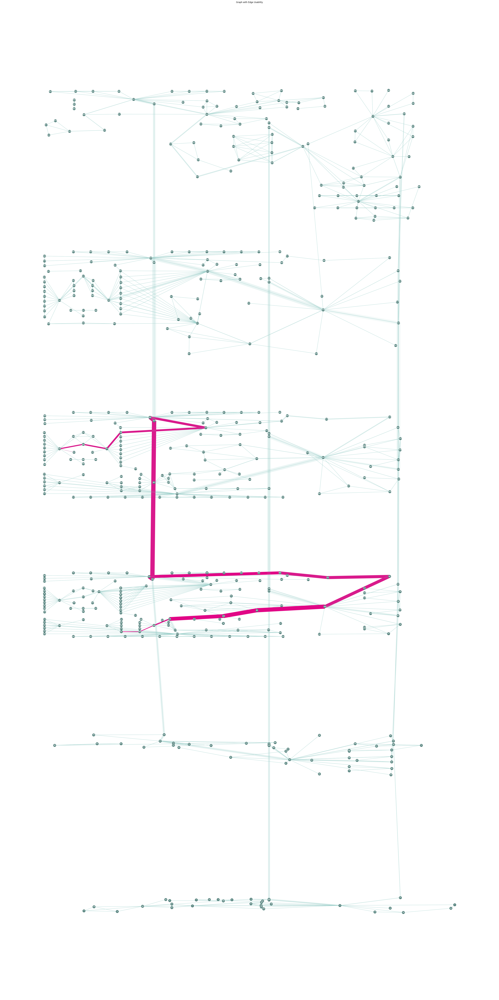

In [27]:
# Get the largest connected component
largest_cc = max(nx.connected_components(access_subgraph), key=len)
G_sub = access_subgraph.subgraph(largest_cc).copy()

# Calculate shortest paths using Dijkstra's algorithm
shortest_paths = dict(nx.shortest_path(G_sub))

# Initialize a dictionary to count edge usage
edge_usage = {}

# Iterate through each pair of nodes and count edge usage
for source in shortest_paths:
    for target in shortest_paths[source]:
        path = shortest_paths[source][target]
        for i in range(len(path) - 1):
            edge = (path[i], path[i + 1])
            if edge in edge_usage:
                edge_usage[edge] += 1
            else:
                edge_usage[edge] = 1

# Find the longest shortest path and its length
longest_path = None
longest_path_length = 0

for source in shortest_paths:
    for target in shortest_paths[source]:
        path = shortest_paths[source][target]
        # Calculate path length as the number of edges in the path
        path_length = len(path) - 1
        if path_length > longest_path_length:
            longest_path = path
            longest_path_length = path_length

# Create a list of tuples representing the edges in the longest path
longest_path_edges = [(longest_path[i], longest_path[i + 1]) for i in range(len(longest_path) - 1)]


plt.figure(figsize=figsize_B)  # Adjust the figure size as needed
nx.draw(access_subgraph, pos, with_labels=True, node_size=250, font_family=font_family,font_size=font_size,font_weight=font_weight, font_color=font_color, node_color=node_col, edge_color=edge_color)


# Draw edges with thickness based on usage count, but highlight the longest path in a different color
max_usage = max(edge_usage.values())
for edge, usage in edge_usage.items():
    if edge in longest_path_edges:
        # Highlight the edge of the longest path in a different color
        nx.draw_networkx_edges(
            G_sub,
            pos,
            edgelist=[edge],
            width=usage / max_usage * 25,  # Scale the thickness based on usage
            edge_color=highlight,  # Use a different color for the longest path
            alpha=1,  # Set edge transparency
        )
    else:
        nx.draw_networkx_edges(
            G_sub,
            pos,
            edgelist=[edge],
            width=usage / max_usage * 25,  # Scale the thickness based on usage
            edge_color=edge_color,
            alpha=0.1,  # Set edge transparency
        )



plt.title("Graph with Edge Usability")
plt.show()

## NEW PLOTS

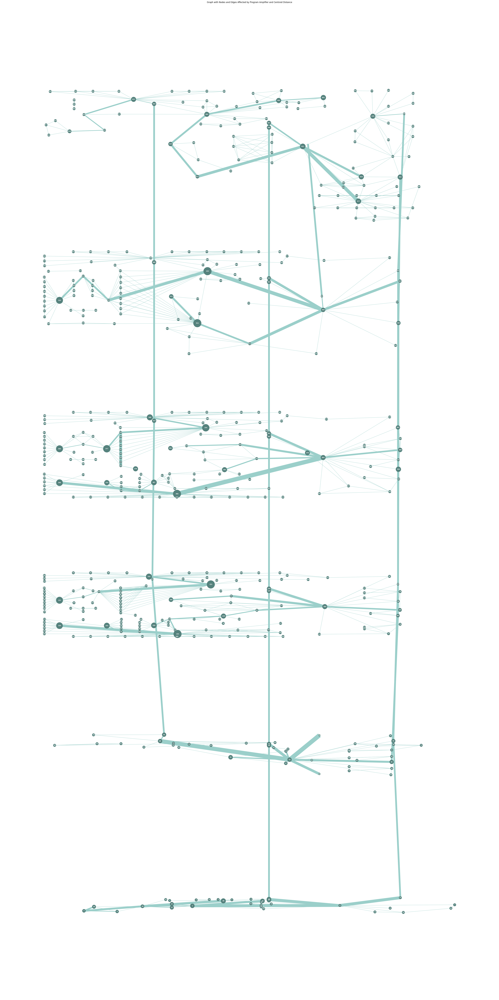

In [30]:
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd

# Read the merged_vertical_edgelist from CSV
merged_path = r'C:\Users\Georgios Bekakos\Desktop\edges_vertical_final.csv'  # Replace with actual path
merged_vertical_edgelist_df = pd.read_csv(merged_path)
merged_edges = set(tuple(x) for x in merged_vertical_edgelist_df[['vi', 'vj']].values)

# Assume program_amplifier_value is the user-input value
program_amplifier_value = 5  # Replace with actual user input

# Always include node 0
selected_nodes = nodes[nodes['Program Amplifier'] >= program_amplifier_value].copy()
selected_nodes = pd.concat([selected_nodes, nodes[nodes['Index'] == 0]])

selected_node_ids = set(selected_nodes['Index'].tolist())

# Filter out edges where Access != 1
access_edges = [(u, v) for u, v, d in access_subgraph.edges(data=True) if d['Access'] == 1]

# Create a new graph using only these edges
access_graph = nx.Graph()
access_graph.add_edges_from(access_edges)

# Use this new graph to calculate the shortest paths from node 0 to all other nodes
shortest_paths = dict(nx.shortest_path(access_graph, weight='Connecting Centroids Distance', source=0))

# Create subgraph for the selected paths
edges_in_shortest_paths = []
for target, path in shortest_paths.items():
    if target in selected_node_ids:
        for i in range(len(path) - 1):
            edges_in_shortest_paths.append((path[i], path[i + 1]))

G_filtered = access_subgraph.edge_subgraph(edges_in_shortest_paths).copy()

# Calculate node sizes based on Circulation Index
node_sizes = []
for node in access_subgraph.nodes():
    if node in selected_node_ids:
        size = selected_nodes.loc[selected_nodes['Index'] == node, 'Circulation Index'].iloc[0] * 1200  # Increase the size
    else:
        size = 250  # Default size
    node_sizes.append(size)

# Initialize a dictionary to collect edge Centroid Distance values
edge_distances = {}
for u, v, data in G_filtered.edges(data=True):
    distance = data['Connecting Centroids Distance']
    edge_distances[(u, v)] = distance

# Draw edges with thickness based on Centroid Distance
max_distance = max(edge_distances.values())
min_distance = min(edge_distances.values())

# Plotting
plt.figure(figsize=figsize_B)
nx.draw(access_subgraph, pos, with_labels=True, node_size=node_sizes, font_family=font_family, font_size=font_size, font_weight=font_weight, font_color=font_color, node_color=node_col, edge_color=edge_color)

for edge, distance in edge_distances.items():
    normalized_distance = (distance - min_distance) / (max_distance - min_distance)
    linewidth = normalized_distance * 25  # Scale the thickness based on normalized distance

    # Check if the edge is in the merged_vertical_edgelist
    if edge in merged_edges or (edge[1], edge[0]) in merged_edges:
        linewidth += 10  # Make it noticeably thicker

    nx.draw_networkx_edges(
        G_filtered,
        pos,
        edgelist=[edge],
        width=linewidth,
        edge_color=edge_color,
        alpha=1  # Set edge transparency
    )

plt.title("Graph with Nodes and Edges Affected by Program Amplifier and Centroid Distance")
plt.show()
